In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import anndata
import scanpy as sc
import os

import matplotlib.pyplot as plt

sc.settings.n_jobs = 24
sc.settings.set_figure_params(dpi=180, dpi_save=300, frameon=False, figsize=(4, 4), fontsize=8, facecolor='white')

In [15]:
data_folders= [r'I:\MERFISH_Analysis\20220304-storm6_M1', 
               r'I:\MERFISH_Analysis\20220329-storm6_M1', 
               r'I:\MERFISH_Analysis\20220415-storm65', 
              ]

adata_list = []
for _data_folder in data_folders:
    
    cell_meta_data_file = os.path.join(_data_folder, 'ExportCellMetadata', 'feature_metadata.csv')
    cell_meta_data = pd.read_csv(cell_meta_data_file)
    counts_file_mer = os.path.join(_data_folder, 'ExportPartitionedBarcodes', 'barcodes_per_feature.csv')
    df = pd.read_csv(counts_file_mer).rename(columns={'Unnamed: 0':'index'}).set_index('index')
    for _c in df.columns:
        if 'Blank-' in _c:
            df = df.drop(columns=_c)
    adata = anndata.AnnData(df)
    adata.obs = adata.obs.merge(cell_meta_data, left_index=True, right_on='Unnamed: 0').set_index('Unnamed: 0')
    adata.obs['experiment'] = os.path.basename(_data_folder).split('-')[0]
    
    #_postanalysis_folder = os.path.join(_data_folder, 'PostAnalysis')
    #_save_filename = os.path.join(os.path.join(_postanalysis_folder, 'filtered_cluster_data.h5ad'))
    #_data = sc.read(_save_filename)
    adata_list.append(adata)
    

C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/1317885315.py:16: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/1317885315.py:16: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(df)
C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/1317885315.py:16: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the 

In [16]:
merged_adata = anndata.concat(adata_list, )

# 3. Preprocess and filter the MERFISH data 

In [20]:
# Calculate quality control metrics
sc.pp.calculate_qc_metrics(merged_adata, percent_top=None, log1p=False, inplace=True)

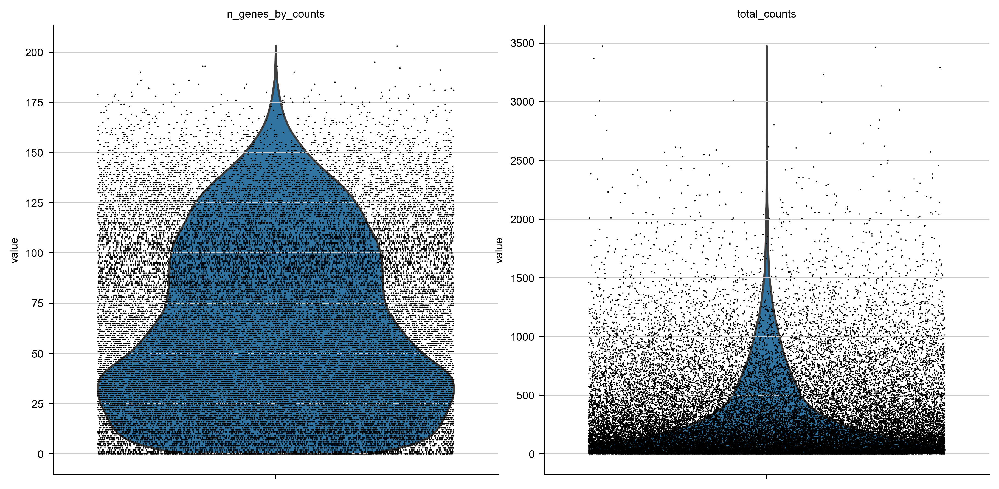

In [21]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

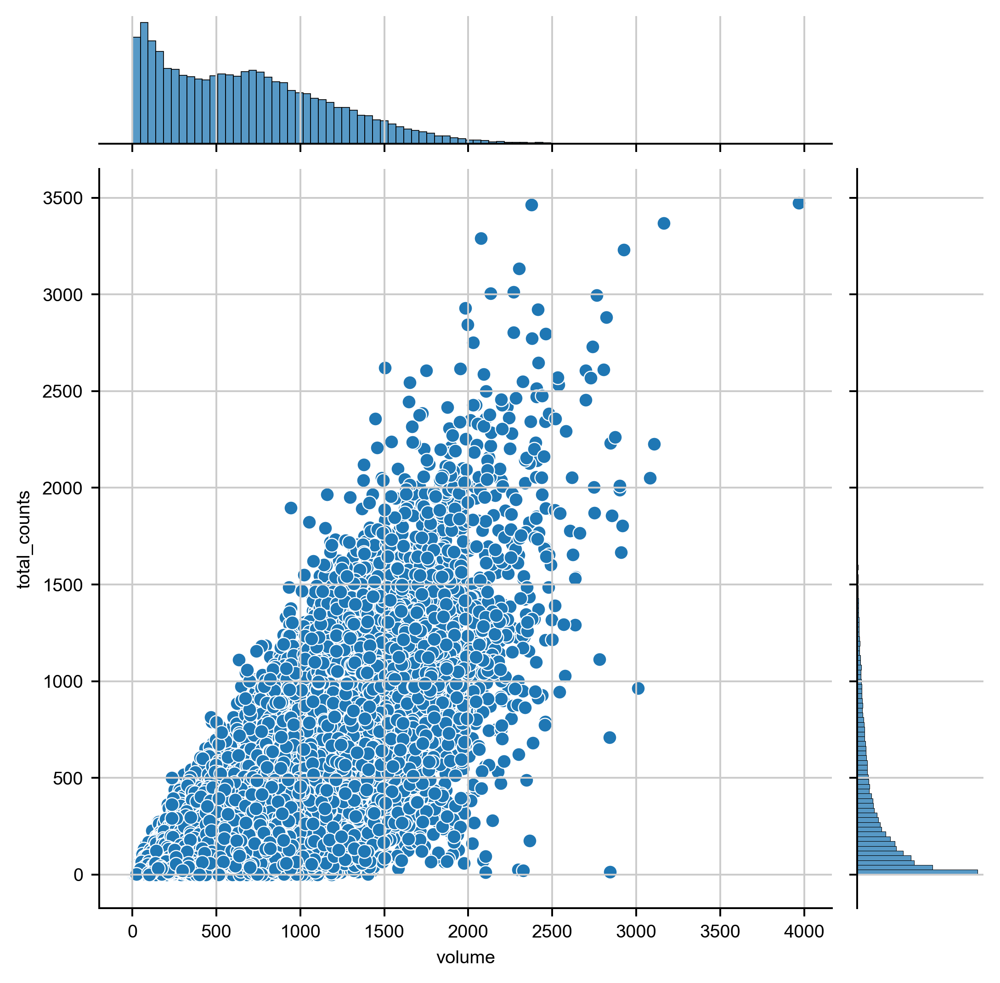

In [23]:
sns.jointplot(data=merged_adata.obs, x='volume', y='total_counts')

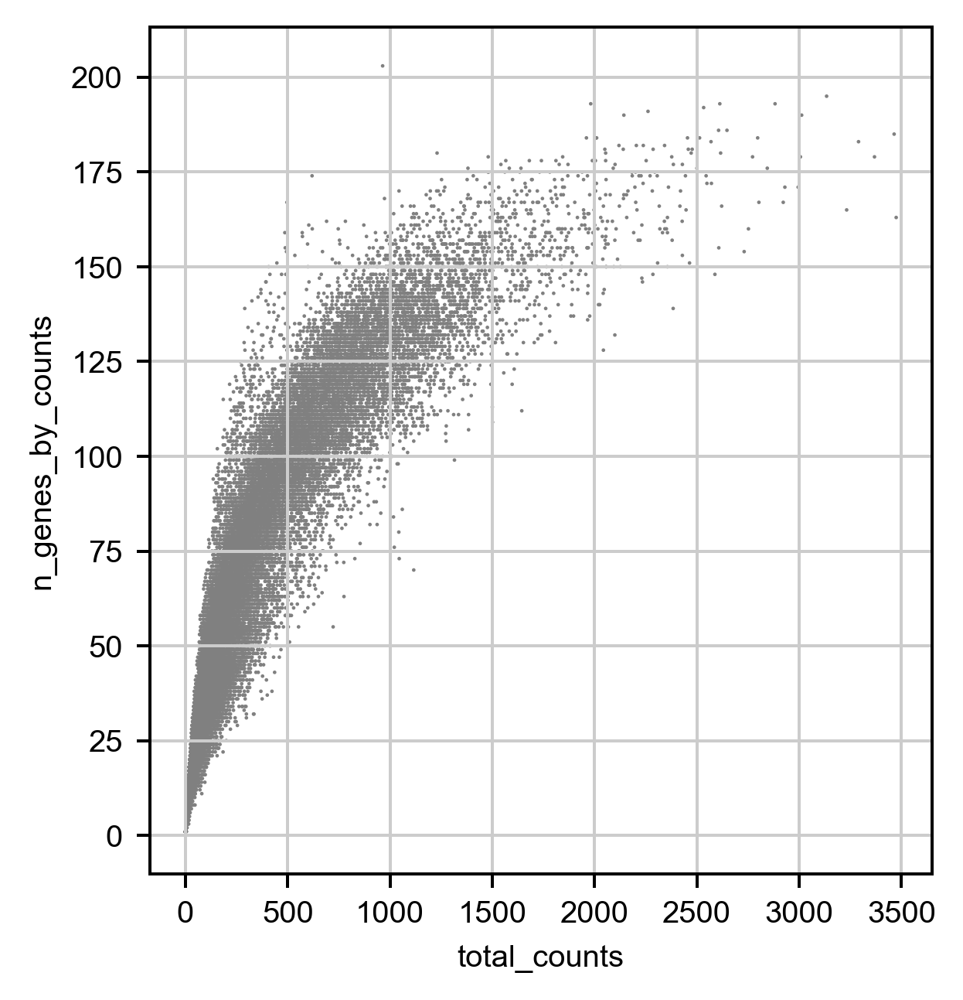

In [24]:
# Plot the distributions of gene counts
sc.pl.scatter(merged_adata, x='total_counts', y='n_genes_by_counts')

In [26]:
gene_count_threshold = 10
total_count_threshold = 20
volume_threshold = 100
volume_upper_threshold = 5000
# Filtering
merged_adata = merged_adata[merged_adata.obs['n_genes_by_counts'] > gene_count_threshold]
merged_adata = merged_adata[merged_adata.obs['total_counts'] > total_count_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] > volume_threshold]
merged_adata = merged_adata[merged_adata.obs['volume'] <= volume_upper_threshold]

print(len(merged_adata))

28672


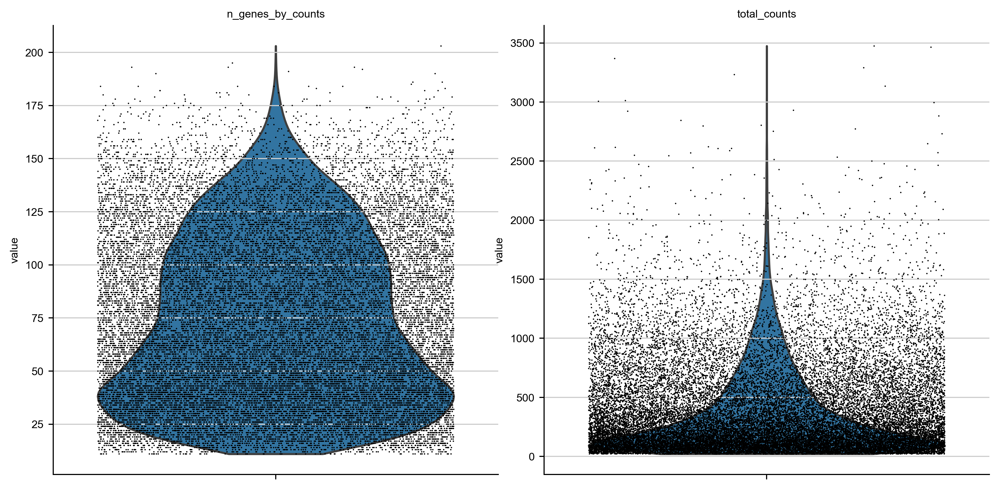

In [27]:
# A violin plot of some of the computed quality measures:
# - the number of genes expressed in the count matrix
# - the total counts per cell
sc.pl.violin(merged_adata, ['n_genes_by_counts', 'total_counts'],
             jitter=0.4, multi_panel=True)

In [28]:
np.mean(merged_adata.obs['total_counts'])

298.2009582519531

# 4. PCA and UMAP of the MERFISH data (for quick test)

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\scanpy\preprocessing\_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


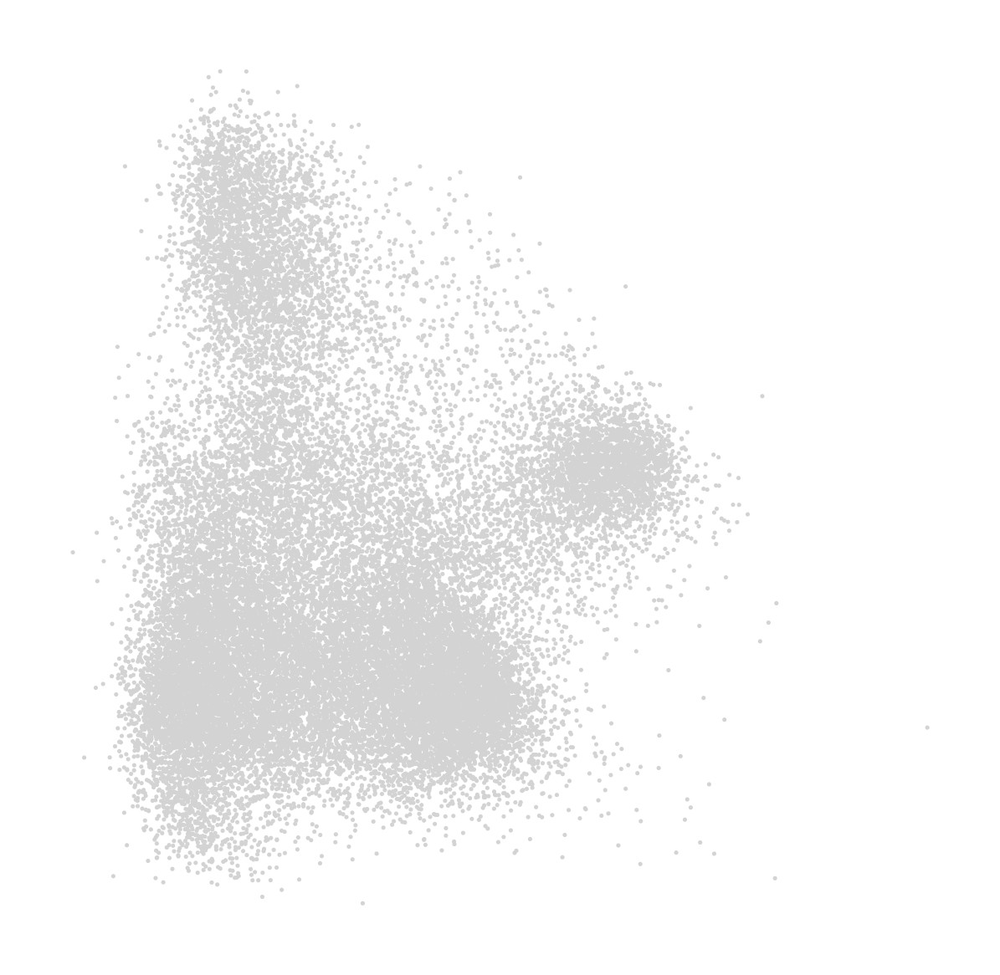

Wall time: 26.7 s


In [30]:
%%time
# Total-count normalize (library-size correct) the data matrix to 10,000 reads per cell
sc.pp.normalize_total(merged_adata, target_sum=1e2)
# Logarithmize the data
sc.pp.log1p(merged_adata)
# Regress out total counts
sc.pp.regress_out(merged_adata, 'total_counts')
# Convert gene expressions to Z-scores
sc.pp.scale(merged_adata, max_value=10)
# Principal component analysis
sc.tl.pca(merged_adata, svd_solver='arpack')
# Plot the PCA results
sc.pl.pca(merged_adata)

In [31]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=10, n_pcs=50)
# Clustering
sc.tl.leiden(merged_adata, resolution=1)

Wall time: 30.5 s


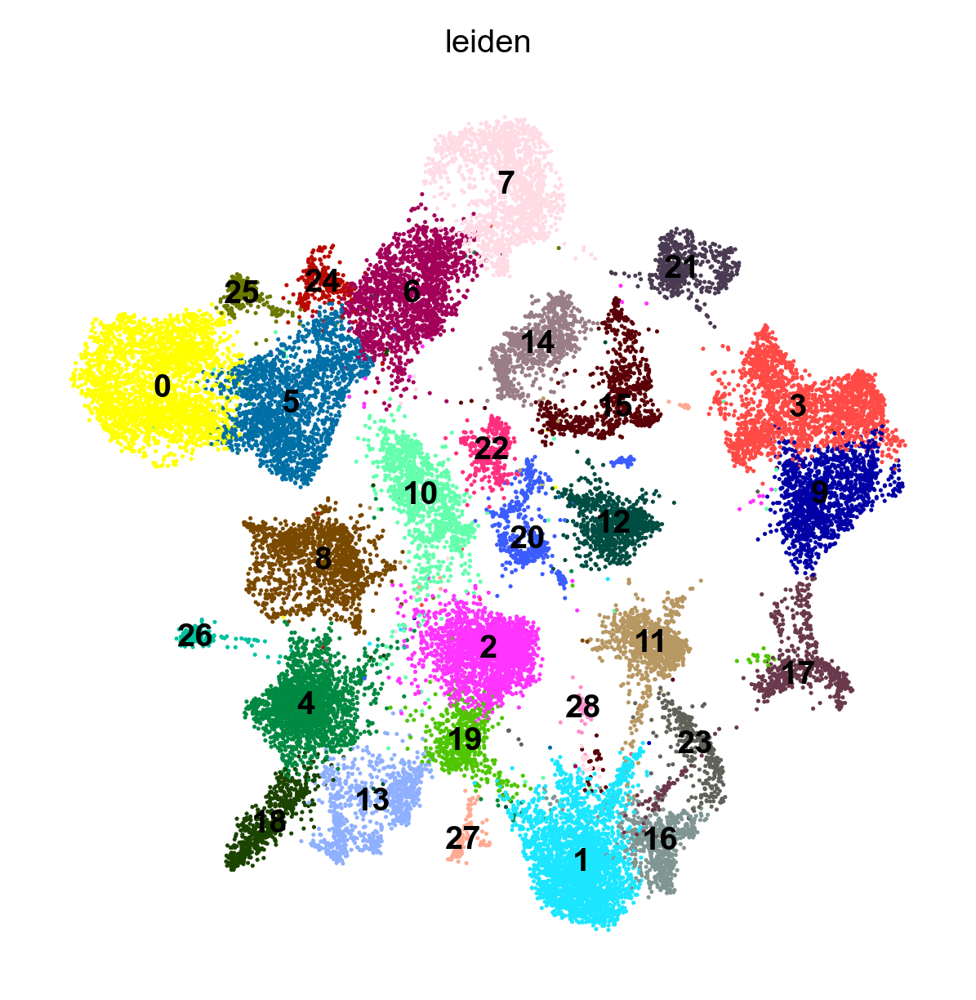

Wall time: 2min 22s


In [32]:
%%time
# Embed with UMAP
sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

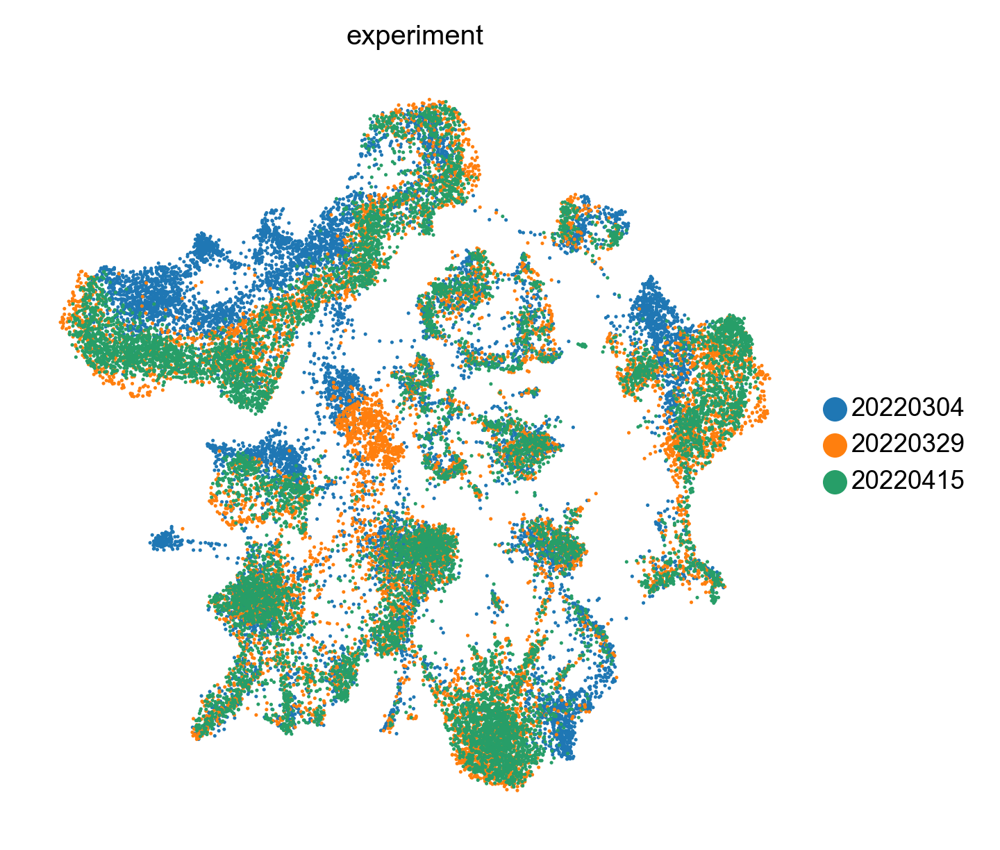

In [34]:
# Plot Umap of different experimental replcates
sc.pl.umap(merged_adata, color='experiment', )

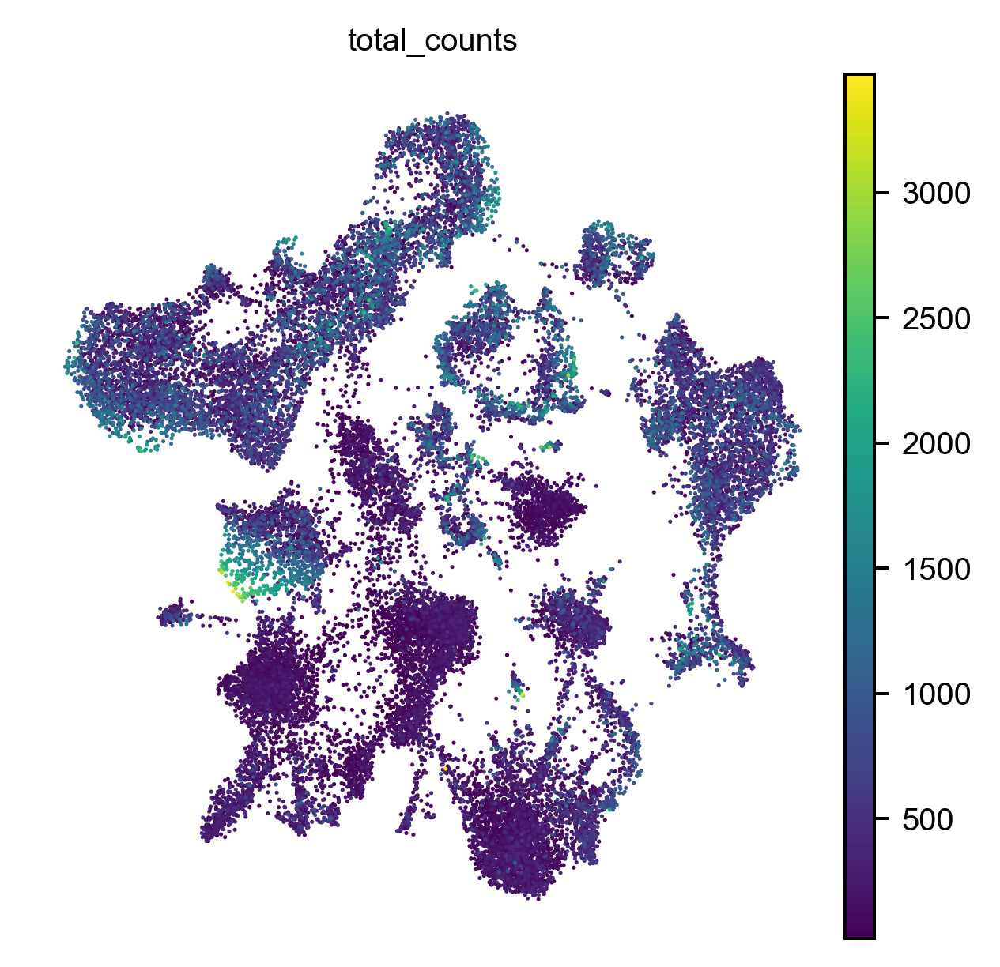

In [36]:
sc.pl.umap(merged_adata, color='total_counts')

# 5. Check count for each cell for genes of interest

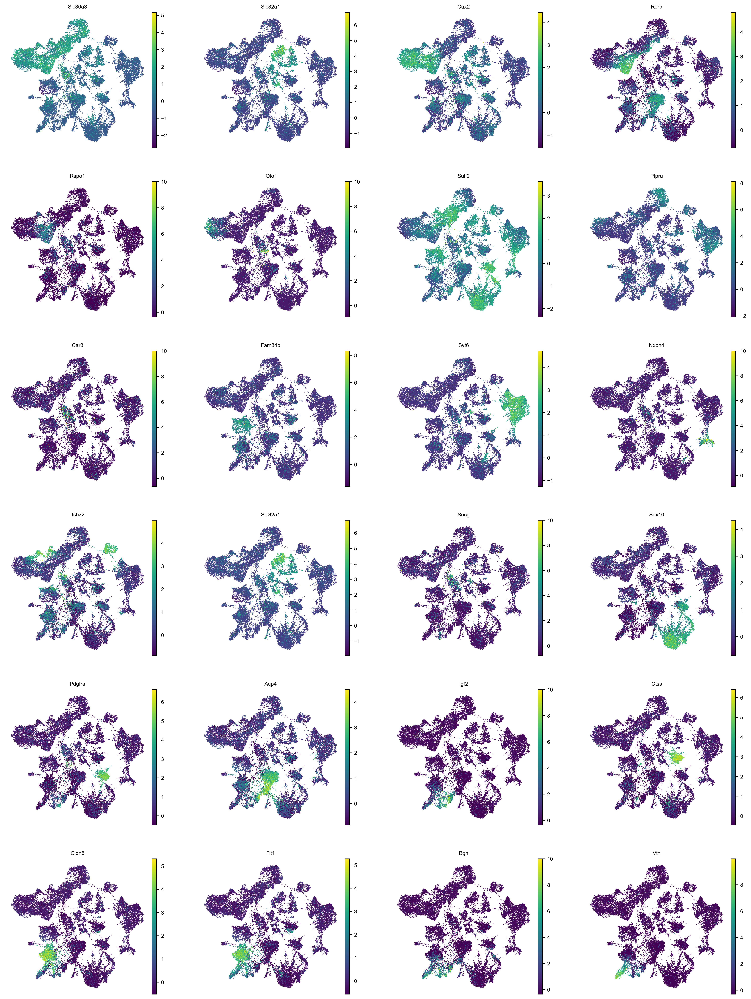

In [38]:
# Visualize marker genes
marker_genes = ['Slc17a7', 'Slc30a3', 'Slc32a1', 'Cux2', 'Rorb', 'Rspo1','Otof','Sulf2', 'Ptpru', 'Car3', 'Fam84b', 'Syt6', 
               'Nxph4', 'Tshz2', 'Pvalb', 'Sst', 'Vip', 'Sncg', 'Lamp5', 'Sox10', 'Pdgfra', 'Aqp4', 'Igf2',
               'Ctss', 'Cldn5', 'Flt1', 'Bgn', 'Vtn']
marker_genes = [g for g in marker_genes if (g in merged_adata.var.index)]

sc.pl.umap(merged_adata, color=marker_genes)

# 6 Test different parameters for UMAP

In [ ]:
%%time
# Computing the neighborhood graph
sc.pp.neighbors(merged_adata, n_neighbors=10, n_pcs=50)

sc.tl.leiden(merged_adata, resolution=1.)

sc.tl.umap(merged_adata)
# Plot the UMAP
sc.pl.umap(merged_adata, color='leiden', legend_loc='on data')

# save this new labels as a new column as 'leiden_subclass'
merged_adata.obs['leiden_subclass'] = merged_adata.obs.leiden

In [40]:
merged_adata.obs['leiden_subclass'] = merged_adata.obs.leiden

# 7. Save the analyzed MERFISH adata in h5ad for later use (e.g., cell classifer)

In [43]:
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save adata into file: I:\MERFISH_Analysis\Merged_MOP\filtered_cluster_data.h5ad


# 8. Cell type classifier

In [44]:
# read from file
save_folder = r'I:\MERFISH_Analysis\Merged_MOP'
save_filename = os.path.join(save_folder, 'filtered_cluster_data.h5ad')
merged_adata = sc.read(save_filename)

## 8.1 load Meng's dataset

In [46]:
meng_merfish_raw = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\counts.h5ad'
merfish_raw = sc.read_h5ad(meng_merfish_raw)
meng_merfish_label = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\Meng_data\cell_labels.csv'
merfish_label = pd.read_csv(meng_merfish_label, index_col=0)

In [47]:
merData = pd.DataFrame(merfish_raw.X, index = merfish_raw.obs.index, columns = merfish_raw.var.index)
labels = merfish_label.loc[merfish_label['label']!='-1']
# merge dataframes
merCluster=merData.merge(labels, how='inner', left_index=True, right_index=True)

In [48]:
from sklearn import preprocessing
# Scale variable measurements for model training
merGroupedDataZ = pd.DataFrame(preprocessing.scale(merCluster.iloc[:,:-5]),index = merCluster.iloc[:,:-5].index, columns = merCluster.iloc[:,:-5].columns)

merGroupedDataZ['subclass'] = merCluster.iloc[:,-2]

E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:235: UserWarning: Numerical issues were encountered when centering the data and might not be solved. Dataset may contain too large values. You may need to prescale your features.
  warnings.warn(
E:\Users\puzheng\AppData\anaconda3\envs\ia3_postanalysis\lib\site-packages\sklearn\preprocessing\_data.py:254: UserWarning: Numerical issues were encountered when scaling the data and might not be solved. The standard deviation of the data is probably very close to 0. 
  warnings.warn(


## 8.2 train classfier with Meng's dataset

In [49]:
adata_ref = merGroupedDataZ

# Train the classifer using the shared varibales
genes_from_ref = set(merData.columns)
genes = list(genes_from_ref.intersection(set(merged_adata.var.index)))

In [50]:
%%time
from sklearn.neural_network import MLPClassifier

# Train a classifier
gene_ids = [merData.columns.get_loc(g) for g in genes]

print('Train cell type classifier.')

X = np.array(adata_ref.iloc[:,:-1])[:, gene_ids]
Y = np.array(adata_ref['subclass'])
nnc = MLPClassifier(max_iter = 500)
nnc.fit(X, Y)

Train cell type classifier.
Wall time: 6h 55min 32s


MLPClassifier(max_iter=500)

In [51]:
import pickle
pickle.dump(nnc, open(os.path.join(save_folder, 'trained_MLP_classifier.pkl'), 'wb'), )

# 8.3 initial prediction

In [52]:
%run "..\..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
import ImageAnalysis3.celltype_tools.classifier as clsf

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/830335642.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


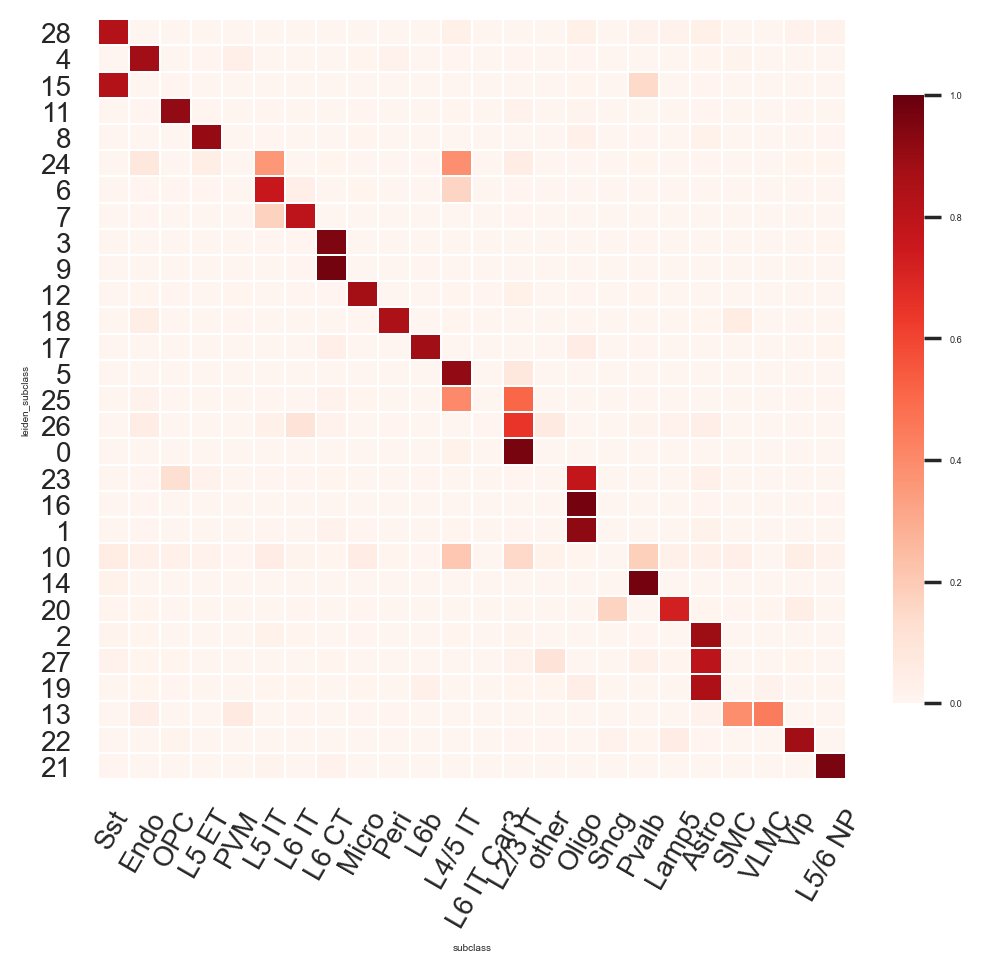

In [53]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5),dpi=100)
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

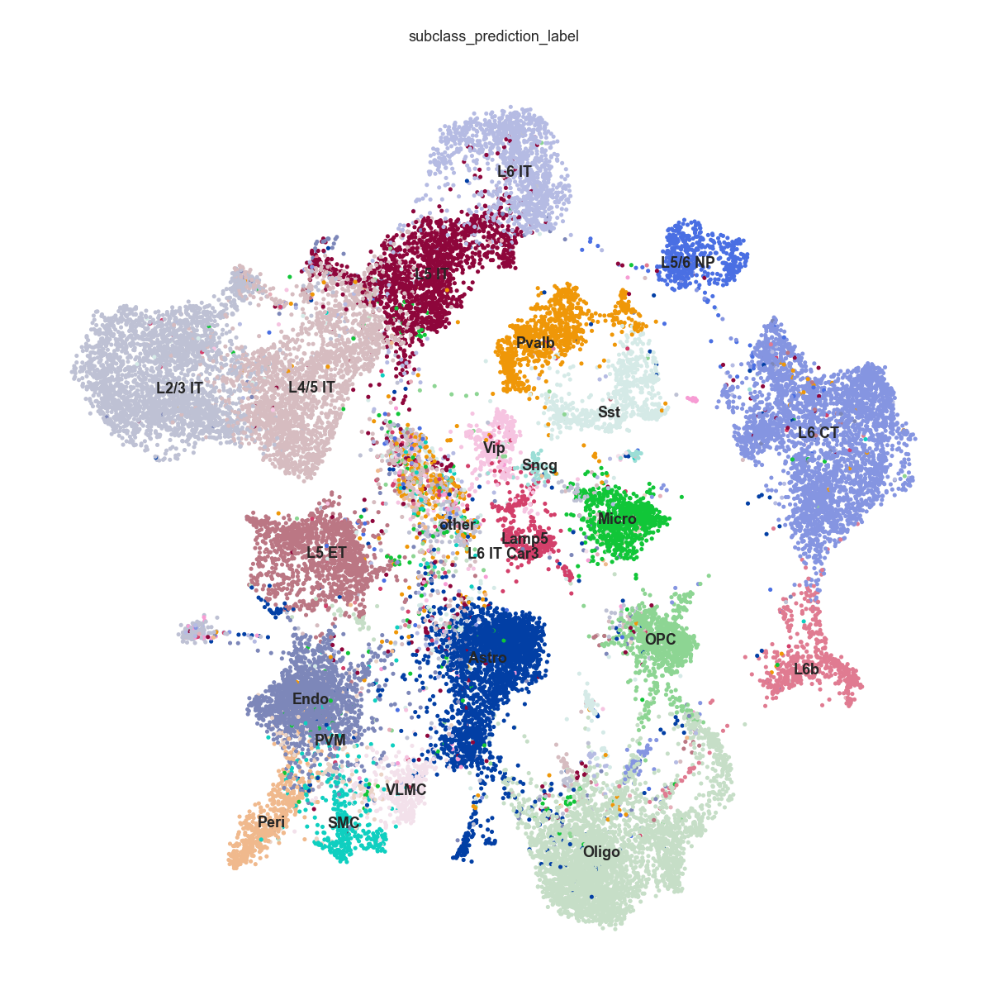

In [54]:
# Plot the predicted labels on UMAP to guide the manual labeling of the de novo clustering below
# use this to manually merge and split the original query column (e.g., leiden_subclass)
sc.pl.umap(merged_adata, color='subclass_prediction_label', legend_loc='on data')

In [ ]:
# Plot clustering as ref
sc.pl.umap(adata, color='leiden_subclass', legend_loc='on data')

## 8.4 Split labels

by comparing two UMAP above, we could estimate which cluster should be further splitted

In [63]:
merged_adata.obs['leiden_subclass_sub'] = merged_adata.obs['leiden_subclass'] 
# manual split
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['4']), key_added='leiden_subclass_sub')

sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['13']), key_added='leiden_subclass_sub')

sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['20']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['24']), key_added='leiden_subclass_sub')
sc.tl.leiden(merged_adata, resolution=0.5, restrict_to=('leiden_subclass_sub',['25']), key_added='leiden_subclass_sub')


#sc.tl.leiden(merged_adata, resolution=0.2,restrict_to=('leiden_subclass_sub',['16,1']), key_added='leiden_subclass_sub')
#sc.tl.leiden(merged_adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['23,0']), key_added='leiden_subclass_sub')
#sc.tl.leiden(merged_adata, resolution=0.5,restrict_to=('leiden_subclass_sub',['23,2']), key_added='leiden_subclass_sub')

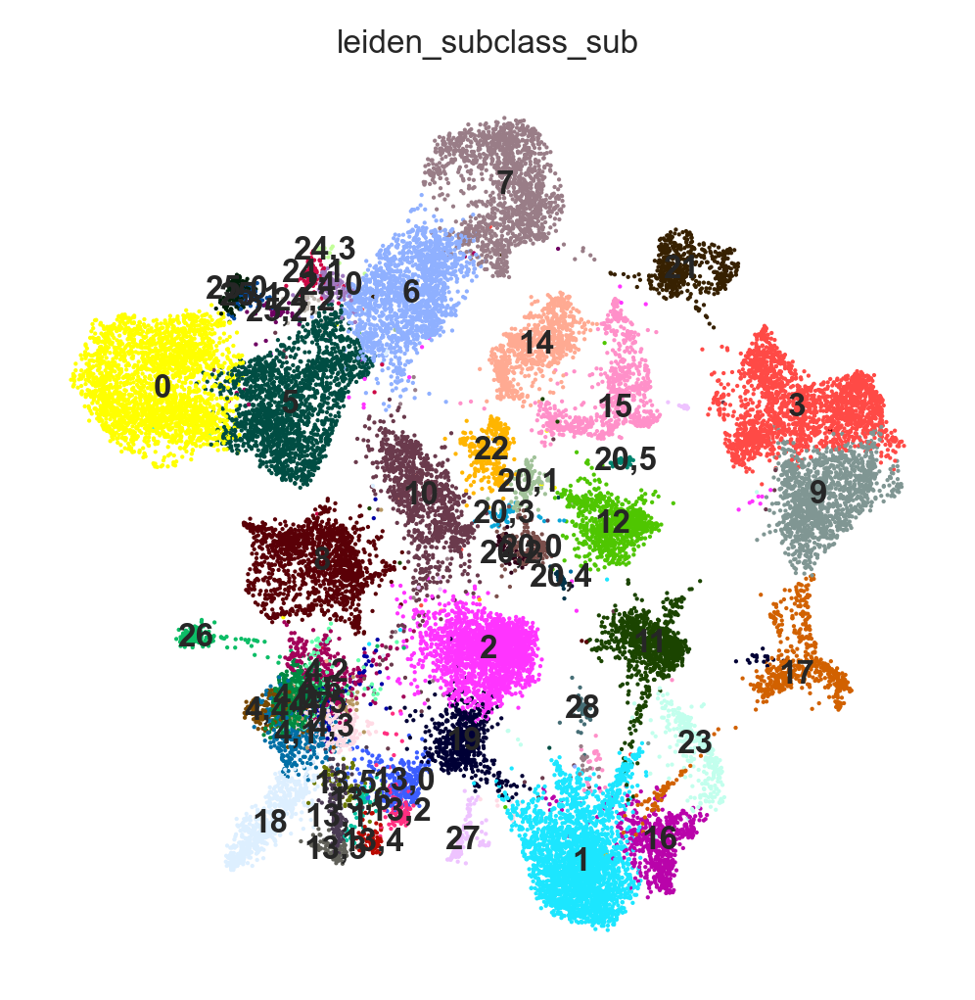

In [64]:
sc.pl.umap(merged_adata, color='leiden_subclass_sub', legend_loc='on data', cmap='Spectral')

## 8.5 further predict splitted groups

Predict cell types.


C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/2326176088.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


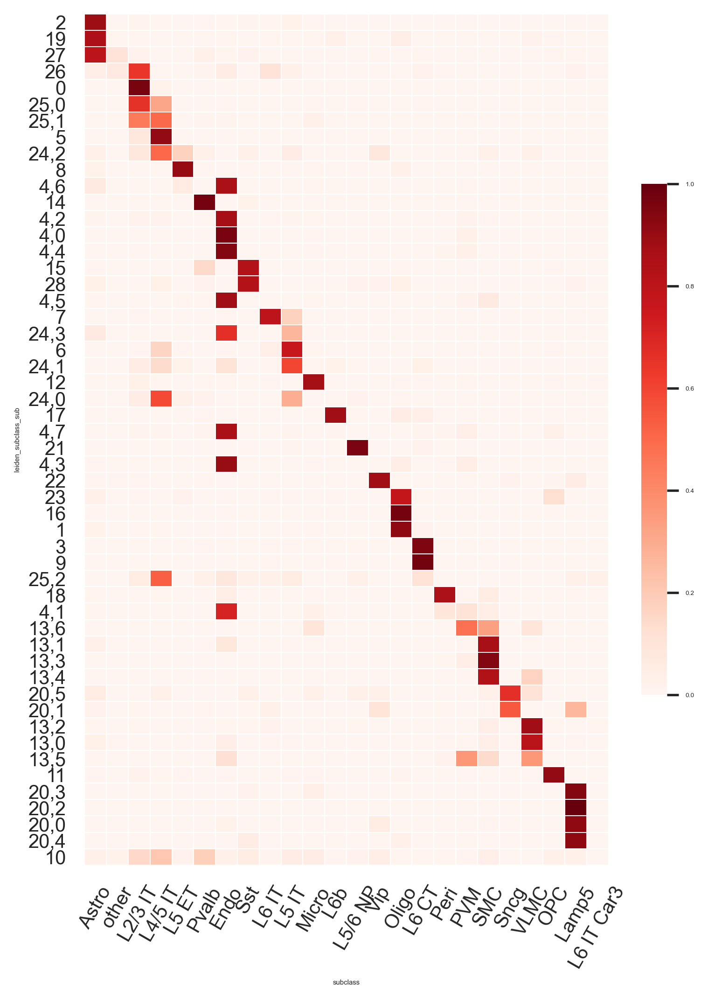

In [65]:
prediction_column = 'subclass_prediction_label'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'leiden_subclass_sub'
#query_cluster_column = 'leiden_cluster'

print('Predict cell types.')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,8))
sns.set(font_scale=0.3)
#sns.heatmap(fractions_sorted, cmap='Greys', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .6})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 60)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

## 8.6 Assign most of uniquely classfied clusters

In [67]:
first_assign_dict = {}
missed_classes = []
# Automatic assign best fit if applicable
assign_th = 0.6
for _cluster, _vec in fractions.iterrows():
    #_cluster, _vec
    _matched_inds = np.where(_vec >= assign_th)[0]
    # if uniquely matched:
    if len(_matched_inds) == 1:
        print(_cluster, list(_vec.keys())[_matched_inds[0]])
        first_assign_dict[_cluster] = list(_vec.keys())[_matched_inds[0]]
    else:
        missed_classes.append(_cluster)

0 L2/3 IT
1 Oligo
2 Astro
3 L6 CT
4,0 Endo
4,1 Endo
4,2 Endo
4,3 Endo
4,4 Endo
4,5 Endo
4,6 Endo
4,7 Endo
5 L4/5 IT
6 L5 IT
7 L6 IT
8 L5 ET
9 L6 CT
11 OPC
12 Micro
13,0 VLMC
13,1 SMC
13,2 VLMC
13,3 SMC
13,4 SMC
14 Pvalb
15 Sst
16 Oligo
17 L6b
18 Peri
19 Astro
20,0 Lamp5
20,2 Lamp5
20,3 Lamp5
20,4 Lamp5
20,5 Sncg
21 L5/6 NP
22 Vip
23 Oligo
24,3 Endo
25,0 L2/3 IT
26 L2/3 IT
27 Astro
28 Sst


In [68]:
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

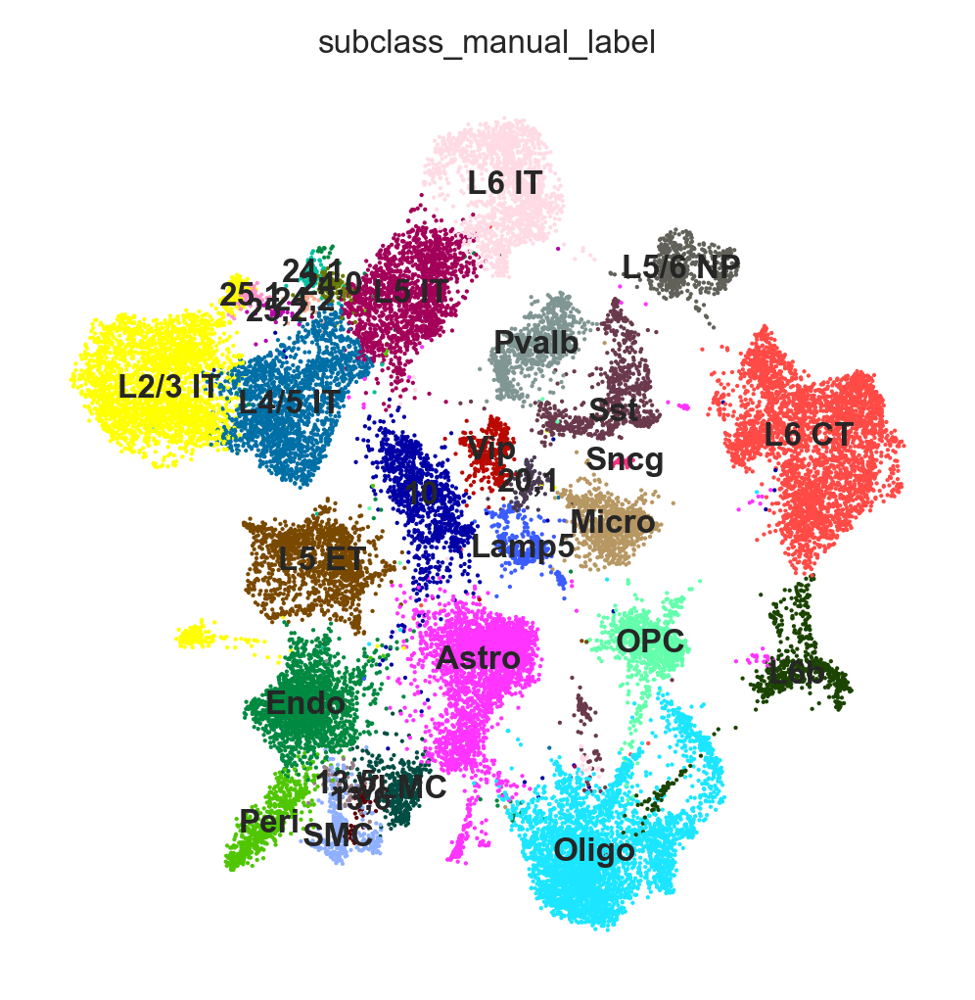

In [69]:
merged_adata.obs['subclass_manual_label'] = merged_adata.obs['leiden_subclass_sub'] 
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':first_assign_dict})
# Check the leftover
np.unique(merged_adata.obs['subclass_manual_label'])
# Plot the predicted sub-subclass
sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data',)

## 8.7 Manual assign leftovers

In [107]:
print(missed_classes)

for _cls in missed_classes:
    print(_cls)
    print((fractions.loc[_cls].index.values)[np.argsort(fractions.loc[_cls].values)[::-1]][::5])
    print(np.sort(fractions.loc[_cls].values)[::-1][::5])

['10', '13,5', '13,6', '20,1', '24,0', '24,1', '24,2', '25,1', '25,2']
10
['L4/5 IT' 'Micro' 'Endo' 'L6 IT' 'L6b']
[0.20776874 0.04968383 0.02439024 0.01445348 0.00542005]
13,5
['VLMC' 'other' 'L5 IT' 'L6b' 'Pvalb']
[0.36206897 0.         0.         0.         0.        ]
13,6
['PVM' 'L6 IT Car3' 'L5 IT' 'L6b' 'Pvalb']
[0.48148148 0.         0.         0.         0.        ]
20,1
['Sncg' 'SMC' 'L6 CT' 'L5/6 NP' 'OPC']
[0.54545455 0.00909091 0.         0.         0.        ]
24,0
['L4/5 IT' 'L5/6 NP' 'L6 CT' 'Micro' 'Sncg']
[0.58974359 0.01709402 0.         0.         0.        ]
24,1
['L5 IT' 'L6b' 'other' 'Oligo' 'Sncg']
[0.59574468 0.0212766  0.         0.         0.        ]
24,2
['L4/5 IT' 'Astro' 'L6 IT' 'L6 IT Car3' 'PVM']
[0.5   0.025 0.    0.    0.   ]
25,1
['L4/5 IT' 'other' 'L6 CT' 'OPC' 'Sncg']
[0.5 0.  0.  0.  0. ]
25,2
['L4/5 IT' 'Lamp5' 'L6 IT Car3' 'Micro' 'SMC']
[0.52777778 0.02777778 0.02777778 0.         0.        ]


In [113]:
sc.settings.n_jobs = 24
#sc.settings.figdir = postanalysis_folder
sc.settings.set_figure_params(dpi=150, dpi_save=300, frameon=False, 
                              figsize=(4, 4), fontsize=8, facecolor='white',)

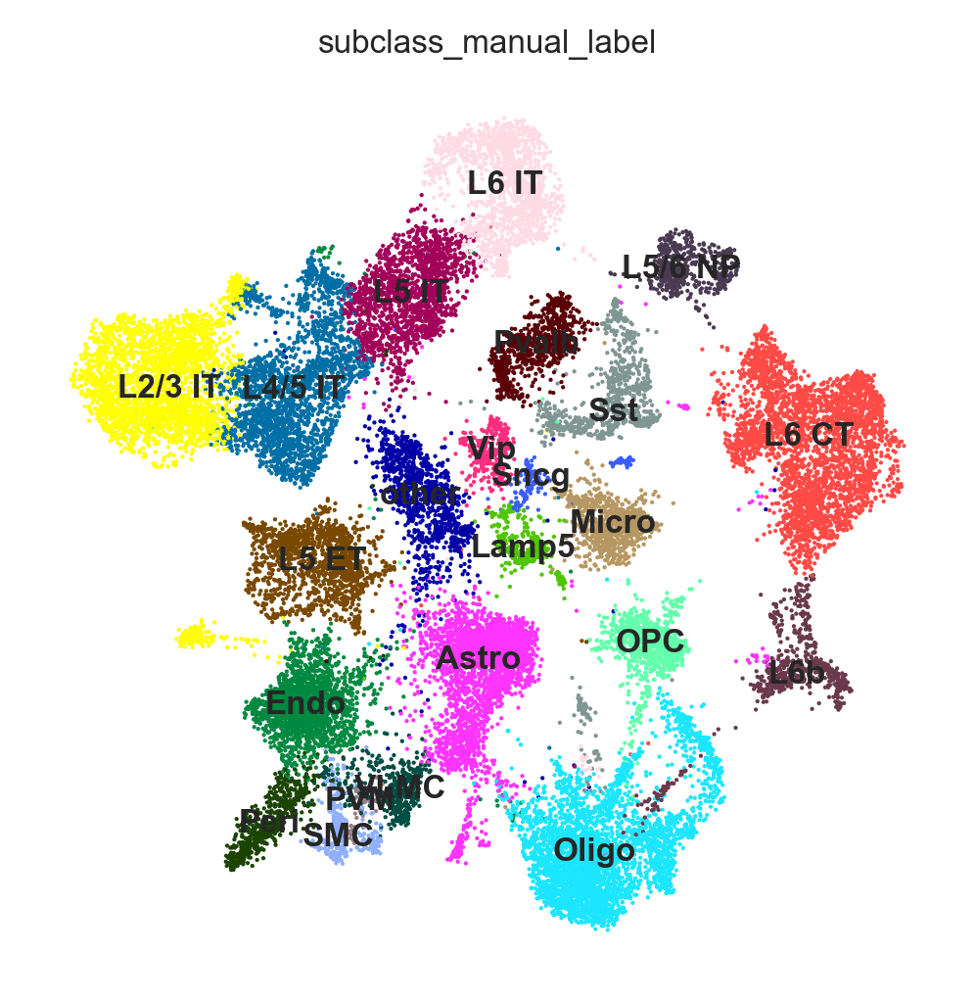

In [114]:
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'10':'other'}})

merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'13,5':'VLMC'}})
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'13,6':'PVM'}})
merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'20,1':'Sncg'}})

merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'24,0':'L4/5 IT', '24,1':'L4/5 IT','24,2':'L4/5 IT','25,1':'L4/5 IT','25,2':'L4/5 IT'}})


#merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'25,1':'L6 CT'}})
#merged_adata.obs = merged_adata.obs.replace({'subclass_manual_label':{'27,0':'L5 ET'}})

np.unique(merged_adata.obs['subclass_manual_label'])

sc.pl.umap(merged_adata, color='subclass_manual_label', legend_loc='on data',)

In [120]:
types, counts = np.unique(merged_adata.obs['subclass_manual_label'], return_counts=True)

In [134]:
for _type, _count in zip(types, counts):
    print(_type, _count)

Astro 2717
Endo 1924
L2/3 IT 2833
L4/5 IT 2274
L5 ET 1346
L5 IT 1643
L5/6 NP 498
L6 CT 3280
L6 IT 1473
L6b 605
Lamp5 358
Micro 817
OPC 912
Oligo 3434
PVM 54
Peri 591
Pvalb 773
SMC 311
Sncg 146
Sst 800
VLMC 440
Vip 336
other 1107


C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/40977473.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(types, rotation=45)
C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/40977473.py:5: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


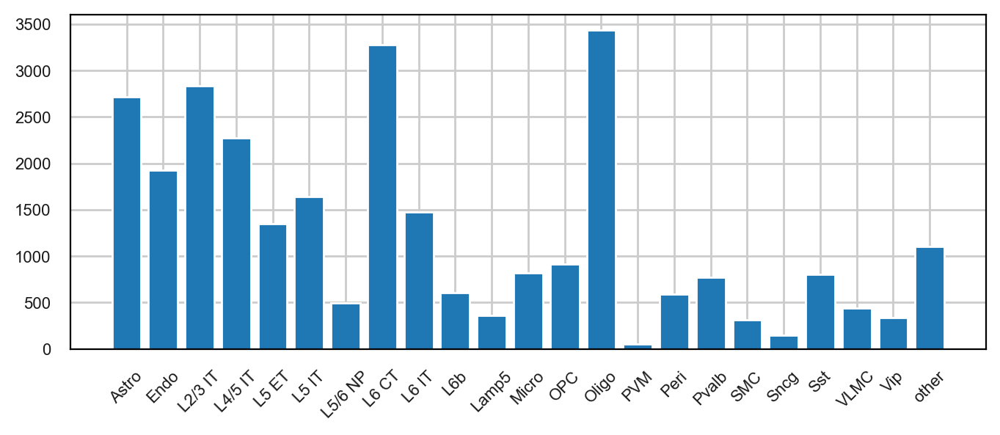

In [131]:
# print class number
fig, ax = plt.subplots(figsize=(8,3), dpi=100)
ax.bar(types, counts)
ax.set_xticklabels(types, rotation=45)
fig.show()

# 9. Redo prediction for manual labels

Check consistency between manual labels vs. predict labels

Predict cell types: subclass_manual_label


C:\Users\puzheng\AppData\Local\Temp/ipykernel_71440/2167453149.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prediction_counts['count'] = 1


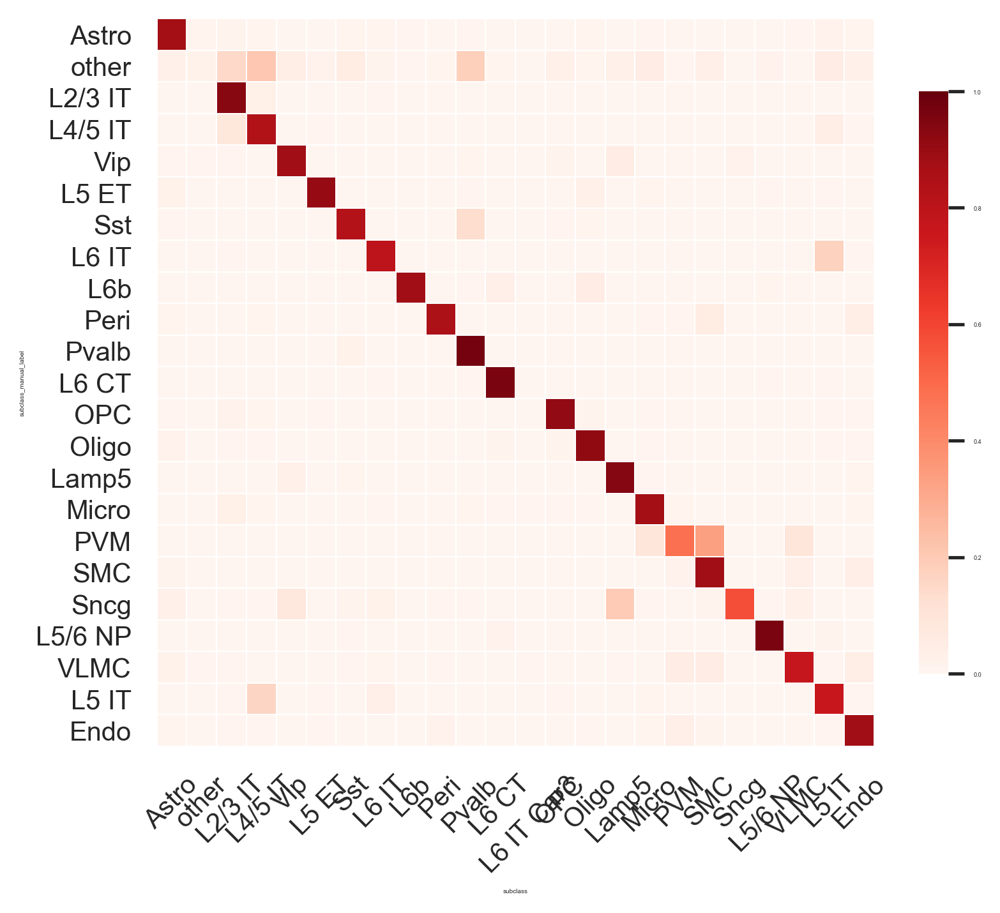

In [111]:
prediction_column = 'subclass_manual_label_predict'

ref_cluster_column = 'subclass'

# determine which class to query
query_cluster_column = 'subclass_manual_label'

print(f'Predict cell types: {query_cluster_column}')
clsf.predict_classes(nnc, merged_adata, prediction_column, genes)
 
    
## Count predictions
prediction_counts = merged_adata.obs[[query_cluster_column, prediction_column]]
prediction_counts['count'] = 1

predictionMatrix = pd.pivot_table(prediction_counts, index=[query_cluster_column],
               columns=[prediction_column], values='count', aggfunc=np.sum).fillna(0)

predictionMatrix['total'] = predictionMatrix.sum(axis = 1)
    
fractions = predictionMatrix.iloc[:,:-1].div(predictionMatrix['total'],axis = 0)
    
#fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Columns')
fractions_sorted, rows, columns = clsf.runPermutation(fractions,'Both')
    
# Plot
fig1=plt.figure(figsize = (6,5))
sns.set(font_scale=0.2)

sns.heatmap(fractions_sorted, cmap='Reds', vmin=0, vmax=1, cbar=True, linewidths=.05,cbar_kws={"shrink": .8})
    
plt.tick_params(axis='x', labelsize=10)
plt.tick_params(axis='y', labelsize=10)   
plt.xticks(rotation = 45)
plt.yticks(rotation = 'horizontal')
plt.xlabel(ref_cluster_column) 
plt.ylabel(query_cluster_column)
plt.show()

# 10. Save manually labeled data

In [112]:
save_filename = os.path.join(os.path.join(save_folder, 'manual_labeled_data.h5ad'))

overwrite = True

if not os.path.exists(save_filename) or overwrite:
    print(f"save merged_adata into file: {save_filename}")
    merged_adata.write(save_filename)
else:
    print(f"savefile: {save_filename} already exists")

save merged_adata into file: I:\MERFISH_Analysis\Merged_MOP\manual_labeled_data.h5ad
